In [2]:
from datasets import load_dataset, Dataset
import sys, os, json, re
sys.path.append(os.path.join(os.getcwd(), '..'))
import pandas as pd
from tqdm.auto import tqdm, trange

dataset = load_dataset("pisterlabs/promptset")

In [3]:
prompts_lsts = dataset["train"]["prompts"]
prompt_lst = []

for prompts in prompts_lsts:
    prompt_lst.extend(prompts)
    
    
prompt_lst = list(set(prompt_lst))
prompt_lst

[' You are a REST API server with an endpoint /generate-random-question/:topic, that generates unique random quiz questions in json data.\n\nFor example, regarding the request: "GET /generate-random-question/devops"\n\nYou can generate the following quiz questions on the topic "devops":\n\n[ {    "content": \'\n\n{\n    "question": "What is the difference between Docker and Kubernetes?",\n    "options": ["Docker is a containerization platform whereas Kubernetes is a container orchestration platform", " Kubernetes is a containerization platform whereas Docker is a container orchestration platform", "Both are containerization platforms", "Neither are containerization platforms"],\n    "answer": "Docker is a containerization platform whereas Kubernetes is a container orchestration platform",\n    "explanation": "Docker helps you create, deploy, and run applications within containers, while Kubernetes helps you manage collections of containers, automating their deployment, scaling, and mor

In [25]:
PROMPT_LIST_ERR = [
    'Please format the following raw transcript for readability, including punctuation, speaker labels (look for semicolons after names), and spacing. Remove filler words:\n\nPLACEHOLDER\n',
    'You are a helpful assistant for Aidan. Your task is to correct any spelling discrepancies in the transcribed text. Only add necessary punctuation such as periods, commas, and capitalization, and use only the context provided. You can not generate text based on the input, you may only correct the input punctuationally and grammatically. If the transcribed text is blank then do not return anything\n\nPLACEHOLDER',
    "Correct the grammar in the sentence: PLACEHOLDER",
    'Reformat the following transcript into Markdown, bolding the speakers. Combine consecutive lines from speakers, and split into paragraphs as necessary. Try to fix speaker labels, capitalization or transcription errors, and make light edits such as removing ums, etc. There is some Danish, please italicize the Danish sentences. Reply with only the corrected transcript as we will be using your output programmatically:\n\nPLACEHOLDER',
    "Please fix the grammatical errors in this English translation of Bhagavad Gita. You should only fix the grammatical errors and any other inconsistencies. Do not change the meaning.\n\nPLACEHOLDER",
    "\n\nHuman: Here is an article, contained in <article> tags:\n\n            <article>\n            {input}\n            </article>\n\n            Please identify any grammatical errors in the article. Also, add the fixed article at the end of answer.\n            \n            Assistant: ",
    "rewrite my message, correct the grammar and make it more friendly, natural, shorter, and clearer. PLACEHOLDER",
    "Correct any grammar mistakes in the following text and return the corrected text: PLACEHOLDER",
    "\n                         Proof read this 'PLACEHOLDER',\n                         and correct any spelling or grammar mistakes.\n                        ",
    "Generate a grammar correction of the following sentence:\n\nPLACEHOLDER",
    'You are mainly an english teacher named Mr.Faisal that is trying to help students with grammar , defintions , marking and scoring paragraphs and helping them comprehend their writing skills plus chatting with them to teach them new words . allow questions in arabic about english and answer them in arabic , if they try to go of topic tell them Sorry student but I can only help with English PLACEHOLDER',
    "\n\tCorrect any grammatical, spelling errors in the question below. \n\tOutput only the corrected version and nothing else\n\tQuestion: {question}\n\tCorrected version: \n\t",
    "Please improve the following text by fixing grammar, spelling, and style:\n\nPLACEHOLDER",
    "You are given some input sentences. Fix the grammar and write the grammatical sentences.\n\ninputs: PLACEHOLDER\n\noutputs:\n",
    'Objective: To enhance official documents written. \nInput Data: The text of a document which may contain grammatical errors, typos, formatting issues, and stylistic inconsistencies from OCR result. \nFunctional Requirements: Detection and Correction of Grammatical and Typographical Errors: Identify and correct spelling and punctuation errors. Check grammatical agreements within sentences.\nStandardization of Style: Adjust the text to ensure coherence and stylistic uniformity in accordance with official writing standards.\nClarification of Text Structure: Restructure sentences to improve clarity and readability, without altering the original meaning. Keep and answer the detected language from the document.\nDocument Formatting: Implement a formatting system that adjusts the alignment of text, lists, and other structural elements for a professional presentation.\nOutput Data: This is the corrected and enhanced document. Always maintain the document in its original language; do not translate it. Respond only in the language detected from the document. Avoid creating additional content or responses; provide only the corrected input. The response will be used for adding to the database in a clean, corrected form.\nThe text: {text}. ',
    "Please rewrite the following text for more clarity and make it grammatically correct. Give me the updated text. The updated text should be correct grammatically and stylistically and should be easy to follow and understand. Only make a change if it's needed. Try to follow the style of the original text. Don't make it too formal. Include only improved text no other commentary.\n\nThe text to check:\n---\nPLACEHOLDER\n---\n\nImproved text: ",
    'Please rephrase the following question into good grammar.\nPlease respond in same language.\n\nQuestion:\n{question}\n\nRephrased question:',
    "Correct the grammar: PLACEHOLDER",
    # TODO: Add two more prompts
]


# Check which key has the err_list prompts 
count = 0
for p in PROMPT_LIST_ERR:
    if p in prompt_lst:
        count += 1
    else:
        # print(p, end="\n###########\n")
        for prompt in prompt_lst:
            if p[:50] in prompt:
                # print(prompt, end="\n###########\n")
                pass
print(count, len(set(PROMPT_LIST_ERR)))

# FInd the duplicates
from collections import Counter
prompt_count_freq = Counter(PROMPT_LIST_ERR)
print(prompt_count_freq)
for k, v in prompt_count_freq.items():
    if v > 1:
        print(k, v)

19 18
Counter({'\n\tCorrect any grammatical, spelling errors in the question below. \n\tOutput only the corrected version and nothing else\n\tQuestion: {question}\n\tCorrected version: \n\t': 2, 'Please format the following raw transcript for readability, including punctuation, speaker labels (look for semicolons after names), and spacing. Remove filler words:\n\nPLACEHOLDER\n': 1, 'You are a helpful assistant for Aidan. Your task is to correct any spelling discrepancies in the transcribed text. Only add necessary punctuation such as periods, commas, and capitalization, and use only the context provided. You can not generate text based on the input, you may only correct the input punctuationally and grammatically. If the transcribed text is blank then do not return anything\n\nPLACEHOLDER': 1, 'Correct the grammar in the sentence: PLACEHOLDER': 1, 'Reformat the following transcript into Markdown, bolding the speakers. Combine consecutive lines from speakers, and split into paragraphs a

You are crafting a professional resume. You are working on a section about your time in {role}.
These are the following activities that you have participated in during that time:

{activities} 1
###########
Isaac newton 1
###########
Activity: PLACEHOLDER 1
###########

AI:
 1
###########
exchange 1
###########
完整翻譯成繁體中文: PLACEHOLDER 1
###########

Output: [Same input text, but with grammatical errors] 1
###########
Title: PLACEHOLDER

PLACEHOLDER 1
###########

    You are helpful assistant. You have to summarize the QUESTION asked by the user into a 
    TOPIC which can be used to retrieve technical papers.
    
    EXAMPLES:
    ---
    QUESTION : "Give me information about tracking objects in real time camera feed"
    TOPIC : "Here is a paper about : Object Tracking in real time camera feed"
    ---
    QUESTION : "Best strategies to preprocess the natural language text"
    TOPIC : "Here is a paper about : Strategies for Preprocessing Natural Language Text"
    ---
    
    You h
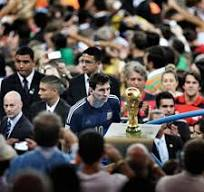
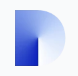

In [24]:
for k, v in prompt_count_freq.items():
    print(k, v, end="\n###########\n")

In [5]:
new_lst = []

for prompt in prompt_lst:
    if len(prompt) > 30:
        new_lst.append(prompt)

print(len(new_lst))

46218


/home/dpaul/.local/lib/python3.10/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


(61448, 384)
(61448, 2)


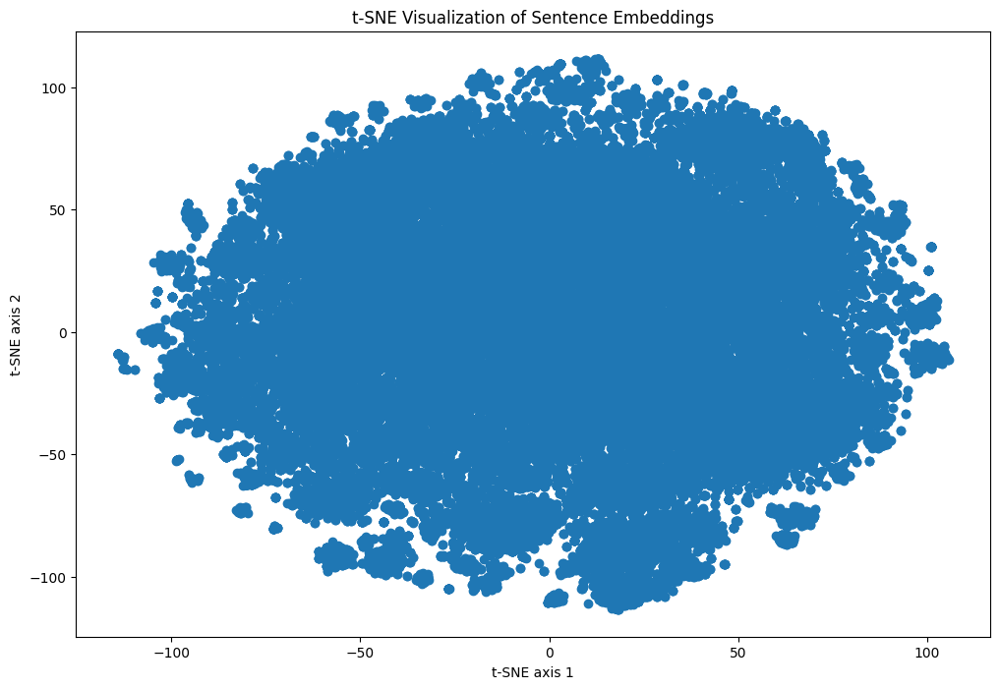

In [5]:
import matplotlib.pyplot as plt
from sentence_transformers import SentenceTransformer
from sklearn.manifold import TSNE
import numpy as np

# Your list of strings
all_strings = prompt_lst
##############################################################################################################

# Step 1: Generate Embeddings
model = SentenceTransformer('all-MiniLM-L6-v2')
embeddings = model.encode(all_strings)
embeddings = np.array(embeddings)
print(embeddings.shape)

# Step 2: Reduce Dimensionality with t-SNE
tsne = TSNE(n_components=2)
embeddings_reduced = tsne.fit_transform(embeddings)
print(embeddings_reduced.shape)

# Step 3: Plotting
x_coords = embeddings_reduced[:, 0]
y_coords = embeddings_reduced[:, 1]
plt.figure(figsize=(12, 8))
plt.scatter(x_coords, y_coords)

# Scatter plot with color mapping
# for x, y in zip(x_coords, y_coords):
#     plt.scatter(x, y, alpha=0.7)

plt.title('t-SNE Visualization of Sentence Embeddings')
plt.xlabel('t-SNE axis 1')
plt.ylabel('t-SNE axis 2')
plt.show()

/tmp/ipykernel_16751/3761834758.py:13: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  palette = plt.cm.get_cmap('turbo', k_optimal)  # 'tab10' provides nice distinct colors


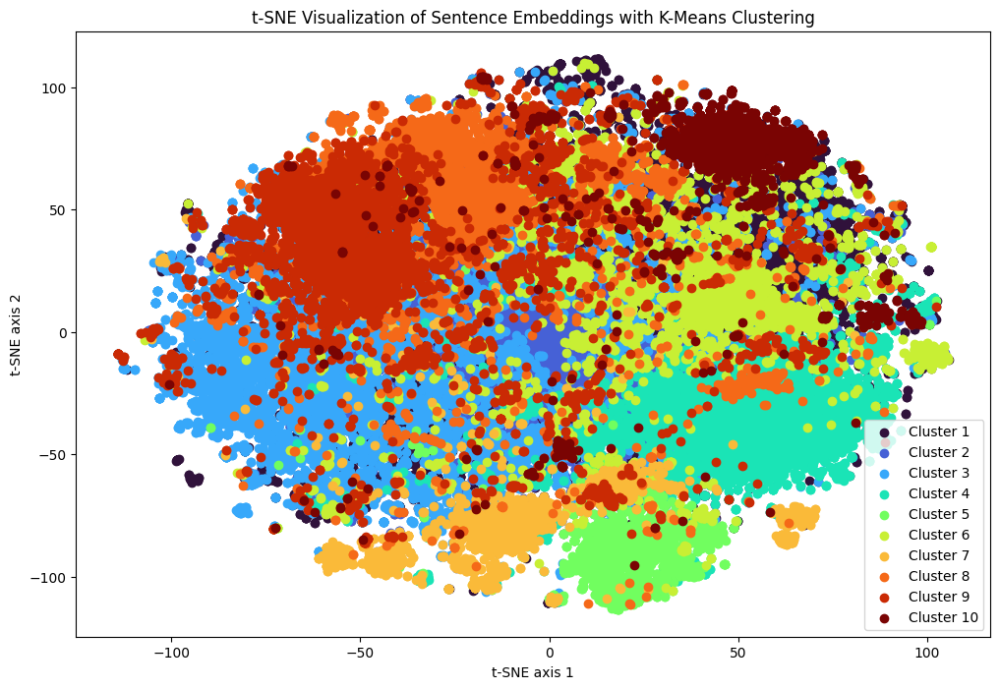

In [6]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt


# Let's assume k_optimal is the optimal cluster count we selected from the elbow plot
k_optimal = 10  # Replace this with the actual optimal number of clusters you have observed

# Now run the K-Means algorithm with the optimal number of clusters
kmeans_optimal = KMeans(n_clusters=k_optimal, init='k-means++', max_iter=300, n_init=10, random_state=0)
cluster_labels = kmeans_optimal.fit_predict(embeddings)

# Then we visualize using a palette that has a nice variety of distinct colors
palette = plt.cm.get_cmap('turbo', k_optimal)  # 'tab10' provides nice distinct colors
plt.figure(figsize=(12, 8))

# Scatter plot with color coding for each cluster
for i in range(k_optimal):
    plt.scatter(x_coords[cluster_labels == i], y_coords[cluster_labels == i], label=f'Cluster {i+1}', c=[palette(i)])

# Shining the spotlight on good design – a must for great UX
plt.title('t-SNE Visualization of Sentence Embeddings with K-Means Clustering')
plt.xlabel('t-SNE axis 1')
plt.ylabel('t-SNE axis 2')

# Add that crisp legend, positioned so it doesn’t smudge our plot
plt.legend()

# And display!
plt.show()

You are given some input sentences. Fix the grammar and write the grammatical sentences.

inputs: PLACEHOLDER

outputs:
 3
###########
Please rewrite the following text for more clarity and make it grammatically correct. Give me the updated text. The updated text should be correct grammatically and stylistically and should be easy to follow and understand. Only make a change if it's needed. Try to follow the style of the original text. Don't make it too formal. Include only improved text no other commentary.

The text to check:
---
PLACEHOLDER
---

Improved text:  1
###########

                         Proof read this 'PLACEHOLDER',
                         and correct any spelling or grammar mistakes.
                         3
###########
rewrite my message, correct the grammar and make it more friendly, natural, shorter, and clearer. PLACEHOLDER 3
###########
Correct the grammar in the sentence: PLACEHOLDER 3
###########
Please improve the following text by fixing grammar, spelling

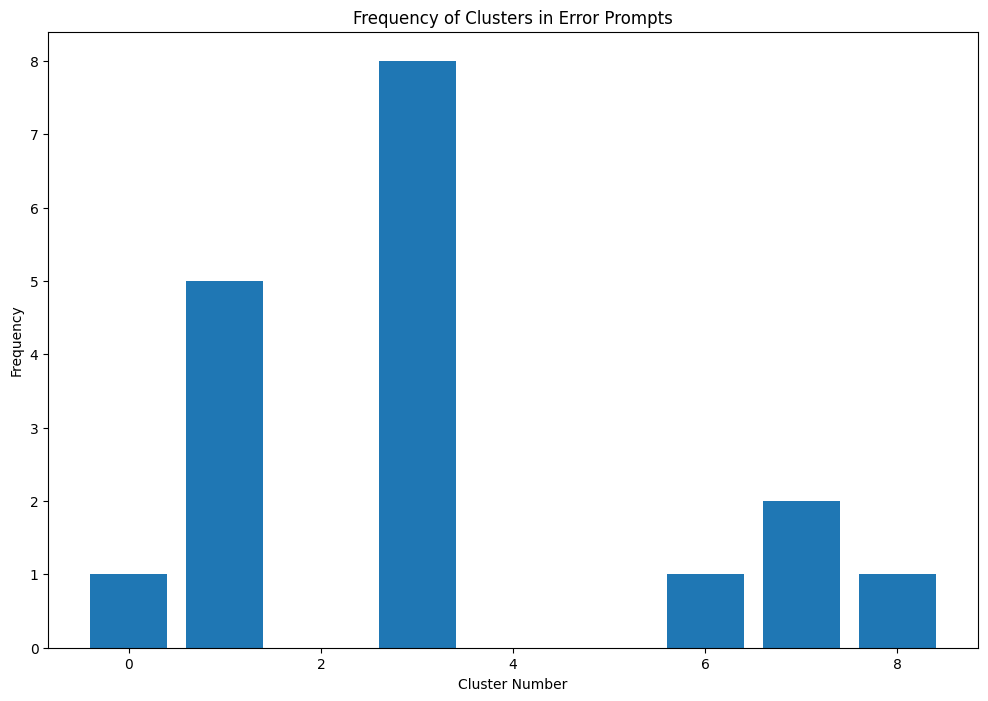

In [7]:
prompt_to_label = {}

for p, c in zip(prompt_lst, cluster_labels):
    if p in PROMPT_LIST_ERR:
        print(p, c, end="\n###########\n")
        prompt_to_label[p] = c

from collections import Counter
# Count frequency of each cluster in prompt_to_label
cluster_freq = Counter(prompt_to_label.values())

# make histogram
plt.figure(figsize=(12, 8))
plt.bar(cluster_freq.keys(), cluster_freq.values())
plt.title('Frequency of Clusters in Error Prompts')
plt.xlabel('Cluster Number')
plt.ylabel('Frequency')
plt.show()

In [8]:
# Make cluster to prompt map
cluster_to_prompt = {}
for i in range(k_optimal):
    cluster_to_prompt[i] = []
    for j in range(len(prompts)):
        if cluster_labels[j] == i:
            cluster_to_prompt[i].append(prompts[j])

# Save cluster to prompt map
import json
with open('temp.json', 'w') as f:
    json.dump(cluster_to_prompt, f)